# Demo: Simulation and Model Fitting in MixedLRMoE.jl (I)

## Introduction

In this notebook, we illustrate how to simulate from the Mixed LRMoE model, as well as fitting a model from the simulated data to recover the true parameters.
We illustrate how to use the `MixedLRMoE.jl` package by walking through each step of the simulation and model fitting process. For the theoretical developments and real data applications of Mixed LRMoE, we refer to [Fung and Tseung (2022+)](https://arxiv.org/abs/2209.15207) and [Tseung et al. (2023)](https://arxiv.org/abs/2209.15212), respectively.

In [1]:
using DrWatson
@quickactivate "Demo-MixedLRMoE-jl"

using Random
using Distributions
using LRMoE
using MixedLRMoE
using Plots

# Plotting setup
FIGSIZE = (500, 500)
FIGDPI = 200;

## Simulation from True Model

Let us use the following basic setups for our simulation study with one level of random effects.
Each step is followed by the code used to generate the data.

In [2]:
# Fix the random seed for reproducibility
Random.seed!(20220525);

* Assume a sample size of 50,000 observations.
* `X` is a 2-dimensional covariate vector (i.e. fixed effects), with an intercept term and a Bernoulli random variable.
* The `exposure` of each observation, i.e. the duration of observation for e.g. a count dataset, is set to one.

In [3]:
sample_size = 50_000
X = hcat(fill(1.0, sample_size), rand(Binomial(1, 0.5), sample_size))
exposure = fill(1.0, sample_size);

* The one-dimensional response `Y` is a two-component mixture of Gamma(2, 1) and Gamma(10, 2).

In [4]:
comp_dist = [GammaExpert(2, 1) GammaExpert(10, 2)]

1×2 Matrix{GammaExpert{Float64}}:
 GammaExpert{Float64}(2.0, 1.0)  GammaExpert{Float64}(10.0, 2.0)

* The regression coefficients `α` before the fixed effects are specified below.

In [5]:
α_true = [1.0 -1.0; 0.0 0.0]

2×2 Matrix{Float64}:
 1.0  -1.0
 0.0   0.0

* Suppose there is one level of random effects `w1`, with 200 unique factors randomly assigned to the 50,000 observations.
* Correspondingly, there exists a mapping vector `t1` which maps each observation to its corresponding factor.

In [6]:
n_factors_1 = 200
w1 = rand(Distributions.Normal(0, 1), n_factors_1)
t1 = sample(collect(1:n_factors_1), sample_size);

We also reshape the random effects into a list of vectors (which will be convenient for multiple levels), as well as the mapping vector(s) into a mapping matrix.

In [7]:
re_list = [w1]
map_matrix = hcat(t1);

* Since there are only two latent classes and one level of random effects, the `β` coefficients are specified as a 2-by-1 matrix. With two latent classes, all entries in `β` are fixed for model identifiability: the first row are always one, and the last row are always zero.

In [8]:
β_true = fill(0.0, 2, 1)
β_true[begin, :] .= 1.0
β_true[end, :] .= 0.0;

With the above, we can simulate the response `Y` as follows.

In [9]:
Y_sim = MixedLRMoE.sim_dataset(α_true, X, comp_dist; β=β_true, re_list=re_list,
    map_matrix=map_matrix, exposure=exposure);

The simulated data looks like the following.

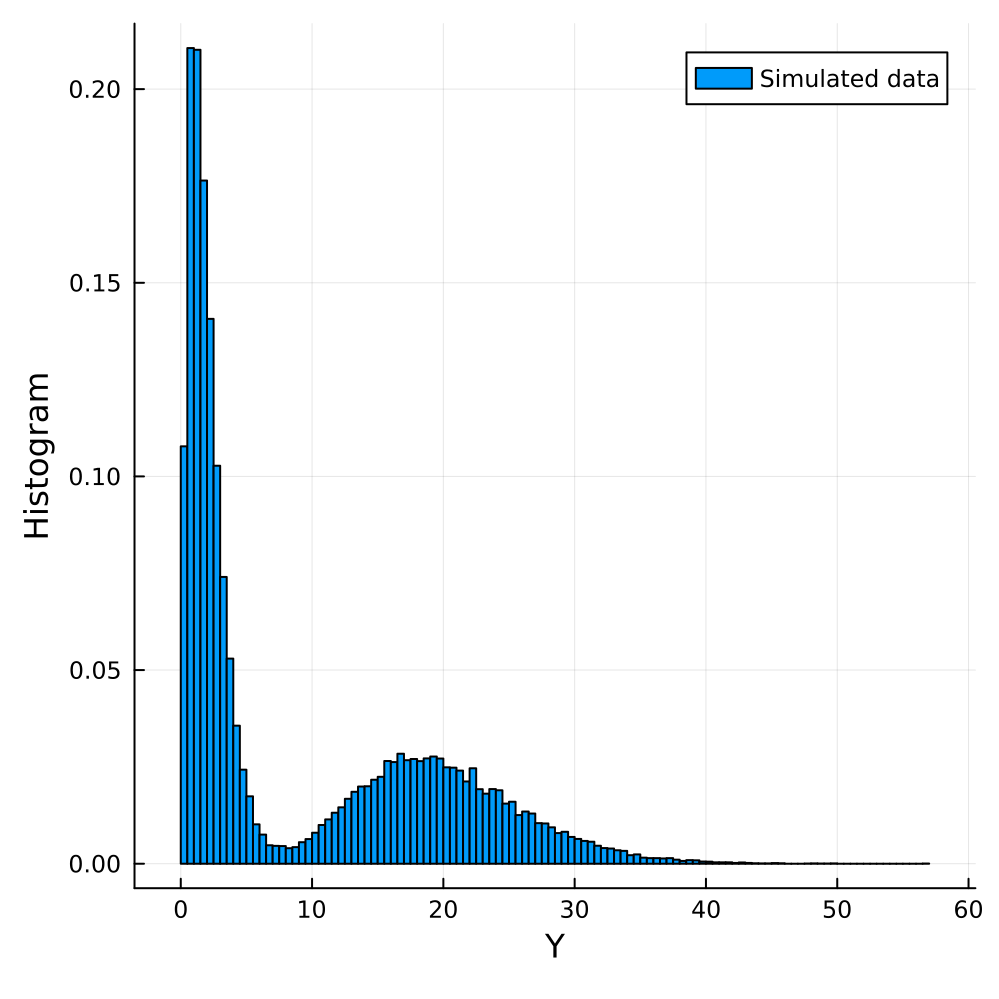

In [10]:
plot(size=FIGSIZE, dpi=FIGDPI)
histogram!(Y_sim, bins=200, label="Simulated data", normalized=true, legend=:topright)
xlabel!("Y")
ylabel!("Histogram")

## Fitting Function to Recover Parameters

Now we attempt to recover the true model parameters and the values of random effects from the simulated data.
The fitting function for Mixed LRMoE is very similar to that in `LRMoE.jl` (see [here](https://actsci.utstat.utoronto.ca/LRMoE.jl/stable/fit/)):
we first need initializations of the regression coefficients `α` for the fixed effects and the component distributions. Let us put a guess reasonably close to the true values.

In [11]:
α_guess = fill(0.0, 2, 2)
comp_guess = [GammaExpert(1.5, 1.5) GammaExpert(8, 2)];

As usual, we also put some small regularizations on these parameters to avoid spurious models.

In [12]:
pen_α = 5.0
pen_params = [[[2.0 10.0 2.0 10.0], [2.0 10.0 2.0 10.0]]];

In Mixed LRMoE, we assume the approximated posterior distribution of the random effects to be factorized multivariate normal, that is, all levels of random effects are independent, and all factors within each level are also independent. Hence, we need to provide the initial guess of the mean vectors `μ` and the diagonal elements of the covariance metrix `Σ`. Both of them are represented by a vector/tuple of vectors.

In [13]:
re_μ_guess = ([fill(0.0, length(w1))])
re_Σ_guess = ([fill(1.0, length(w1))]);

We also specify the initial guess of the `β` coefficients in front of the random effects. Again, since there are only two latent classes, all entries in `β_guess` are actually fixed values and not altered during the model fitting procedure.

In [14]:
β_guess = fill(1.0, 2, 1)
β_guess[end, :] .= 0.0;

Now we are ready to call the fitting function for Mixed LRMoE, which relies on a stochastic version of the variational Expectation-Conditional-Maximazation (ECM) algorithm. Below, we specify 5 simulations (`n_sims`) for stochastically evaluating the Evidence Lower Bound (ELBO) in each iteration, and 50 iterations in total (`ecm_iter_max`) with intermediate steps printed every `print_steps` iterations (or no printing when set to `false`).

In [15]:
result = MixedLRMoE.fit_exact_VI(Y_sim, X, α_guess, comp_guess,
    β_guess, map_matrix,
    re_μ_guess, re_Σ_guess;
    exposure=exposure,
    n_sims=5,
    penalty=true,
    pen_α=pen_α, pen_params=pen_params,
    α_iter_max=5.0, ecm_iter_max=50,
    print_steps=false)

(α_fit = [1.0025671127603495 -1.0264265337669478; 0.0 0.0], β_fit = [1.0; 0.0;;], model_fit = GammaExpert{Float64}[GammaExpert{Float64}(2.001849398743309, 0.9919201693628565) GammaExpert{Float64}(10.31386467172919, 1.9419618033862207)], re_μ_fit = [[0.827668504817986, -0.43638963941518594, -0.06652372689125721, 0.023033345539722156, 0.3206033728148811, 1.171727966531695, -1.4153990614984582, -0.9189039231584054, 0.01924643866799377, 0.3220915587088565  …  -1.0976598141824156, 0.397072194151773, 1.143971064563111, -1.2832605346466353, -1.494586002713383, -1.2961783488855452, -1.7051337725769895, -0.2682610183241141, 0.15220992189632354, -0.5113219252334332]], re_Σ_fit = [[0.02641967592510847, 0.056335886901797146, 0.0645850631448586, 0.057485976866882706, 0.04096545705612504, 0.07966232523672442, 0.04786177692836799, 0.045489358112503736, 0.04654429926978366, 0.05106396827936289  …  0.017593761512437734, 0.053676303966678184, 0.03555817844658061, 0.03986912277865832, 0.07379613256961991

We can check verify the algorithm indeed recovers the true model parameters.

In [16]:
println("True α: ", α_true)
println("Fitted α: ", result.α_fit)

println("True Component 1: ", comp_dist[1, 1])
println("Fitted Component 1: ", result.model_fit[1, 1])

println("True Component 2: ", comp_dist[1, 2])
println("Fitted Component 2: ", result.model_fit[1, 2])

True α: 

[1.0 -1.0; 0.0 0.0]
Fitted α: [1.0025671127603495 -1.0264265337669478; 0.0 0.0]
True Component 1: GammaExpert{Float64}(

2.0, 1.0)
Fitted Component 1: GammaExpert{Float64}(2.001849398743309, 0.9919201693628565)
True Component 2: GammaExpert{Float64}(10.0, 2.0)
Fitted Component 2: GammaExpert{Float64}(10.31386467172919, 1.9419618033862207)


The convergence can also be checked by looking at the history of ELBO values, which stabilizes after around 20 iterations.

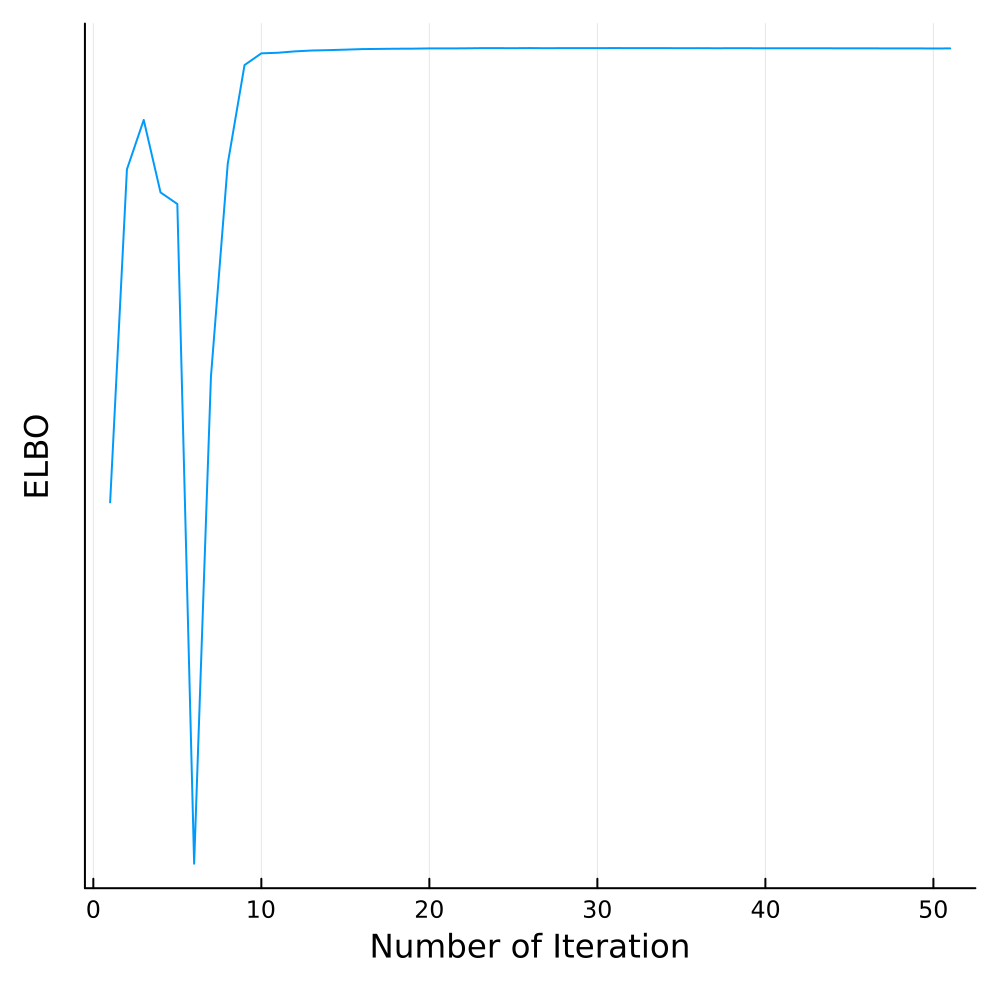

In [17]:
plot(size=FIGSIZE, dpi=FIGDPI)
plot!(result.ll_history; label="")
xlabel!("Number of Iteration")
ylabel!("ELBO")
yticks!([0], [""])

The **approximated** posterior distribution of the random effects is specified by the mean vector `re_μ_fit` and the covariance matrix `re_Σ_fit`.
We observe that they also reasonably covers the true simulated values, with the 95% credible intervals mostly covering the 45-degree line.

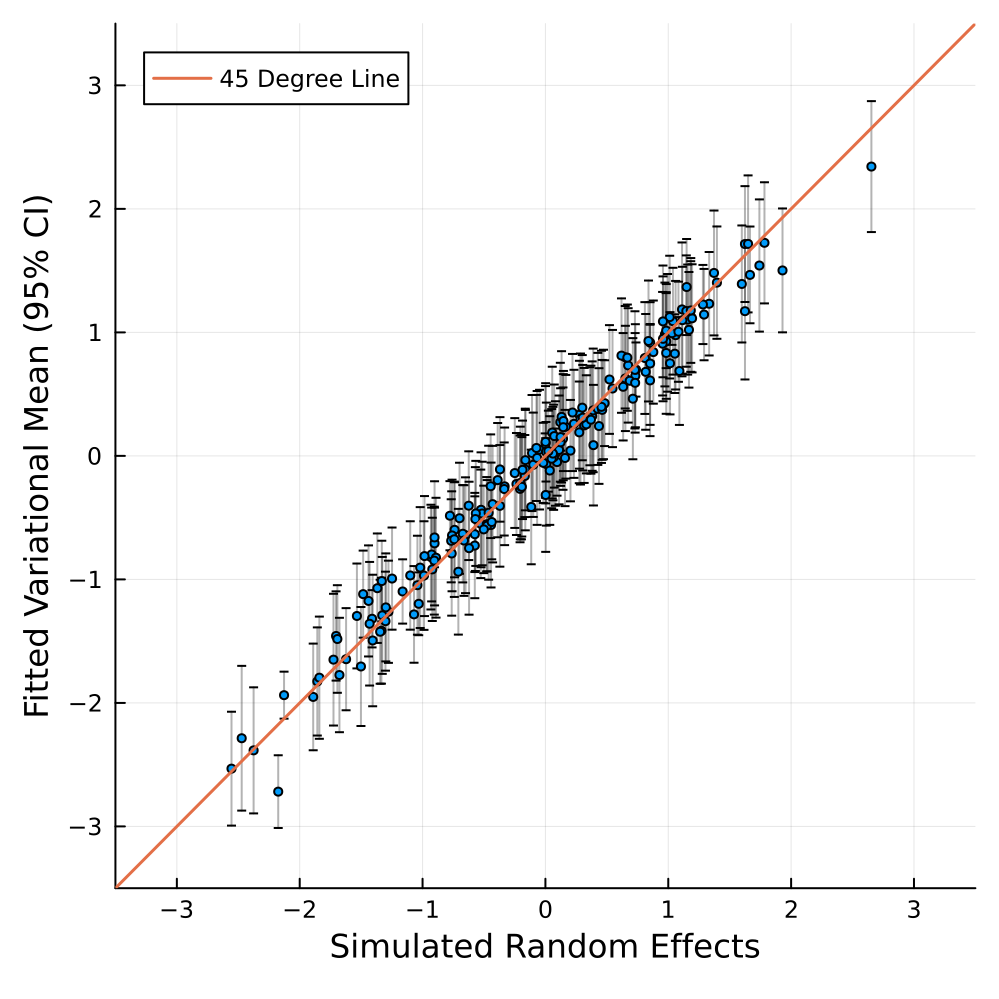

In [18]:
plot(size=FIGSIZE, dpi=FIGDPI)
scatter!(w1, result.re_μ_fit[1];
    markersize=2.25,
    yerror=(1.96 .* sqrt.(result.re_Σ_fit[1]),
        1.96 .* sqrt.(result.re_Σ_fit[1])),
    linealpha=0.30,
    label="",
    size=FIGSIZE)
xlims!(-3.5, 3.5)
ylims!(-3.5, 3.5)
xlabel!("Simulated Random Effects")
ylabel!("Fitted Variational Mean (95% CI)")
plot!([-4, 4], [-4, 4]; linewidth=1.5, label="45 Degree Line", legend=:topleft)

In [19]:
# Coverage:
for (q, z) in zip([0.90, 0.95, 0.975, 0.99], [1.64, 1.96, 2.24, 2.58])
    true_re = w1
    fitted_lb = result.re_μ_fit[1] - z .* sqrt.(result.re_Σ_fit[1])
    fitted_ub = result.re_μ_fit[1] + z .* sqrt.(result.re_Σ_fit[1])
    check_sign = (true_re .- fitted_lb) .* (fitted_ub .- true_re)
    println("Posterior CI level: $(q)")
    println("Number of levels: $(length(true_re))")
    println(
        "Number within $(q*100)% CI: $(sum(check_sign .> 0)), or $(sum(check_sign .> 0) / length(true_re) * 100)%",
    )
end

Posterior CI level: 0.9
Number of levels: 200
Number within 90.0% CI: 191, or 95.5%
Posterior CI level: 0.95
Number of levels: 200
Number within 95.0% CI: 195, or 97.5%
Posterior CI level: 0.975
Number of levels: 200
Number within 97.5% CI: 198, or 99.0%
Posterior CI level: 0.99
Number of levels: 200
Number within 99.0% CI: 198, or 99.0%


## Visualizing the Fitted Distribution and Latent Class Probabilities

We can further investigate the fitted distribution by stochastically obtaining the latent class probabilities for each observation, as well as the overall fitted distribution. Note this requires simulating from the **approximated** posterior distributions, which are essentially multivariate normal distributions, so it is not very computationally demanding.

In [20]:
# specify some parameters for plotting
plt_series = collect(0:0.02:50)
dens_series_train = fill(0.0, length(plt_series))
α_fit = result.α_fit
model_fit = result.model_fit;

We simulate 200 realizations of random effects from their posterior, and then average them out to obtain the latent class probabilities and the overall fitted distribution.

In [21]:
# simulate 200 times from the posterior of random effects
# and then evaluate the gating function
predict_gating = MixedLRMoE.LogitGating(result.α_fit, result.β_fit)
predict_gating_eval = fill(0.0, size(X)[1], 2)

n_sim = 200
for i in 1:n_sim
    Random.seed!(2020 + i)
    sim_re = MixedLRMoE.LogitGatingSim(predict_gating, X;
        re_μ_list=result.re_μ_fit,
        re_Σ_list=result.re_Σ_fit,
        map_matrix=map_matrix)
    predict_gating_eval = predict_gating_eval + exp.(sim_re)
end

predicted_weights = predict_gating_eval ./ n_sim;

The overall fitted densities are the average of the individual fitted densities across all 50,000 observations.

In [22]:
# evaluate the fitted density function
dens_eval = hcat(
    [exp.(LRMoE.expert_ll_exact.(model_fit[1, j], plt_series)) for j in 1:2]...
)
dens_series_train = mean(dens_eval * predicted_weights'; dims=2);

We observe that the fitted distribution is very close to the true distribution.

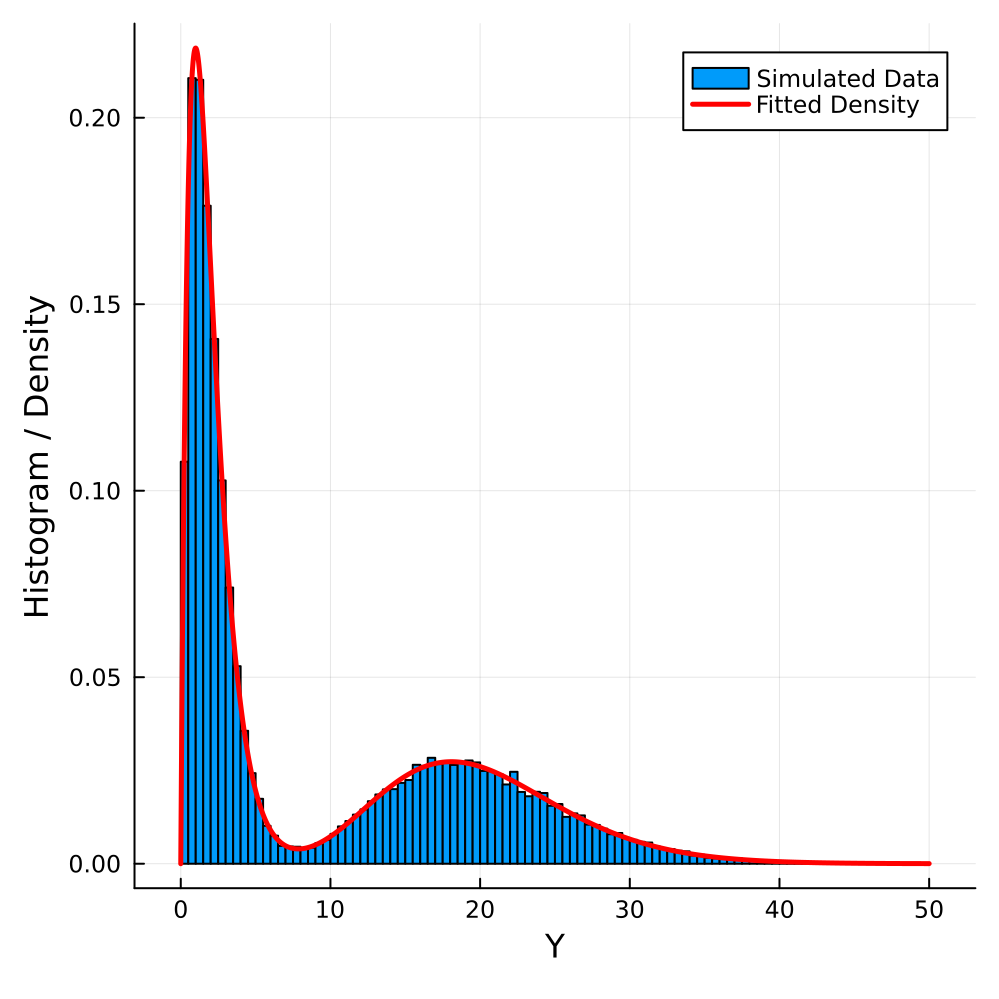

In [23]:
# comparison
plot(size=FIGSIZE, dpi=FIGDPI)
histogram!(Y_sim; bins=0:0.5:50, normalize=true, label="Simulated Data",
    size=FIGSIZE)
plot!(plt_series, dens_series_train; linecolor=:red, linewidth=2.5, label="Fitted Density")
xlabel!("Y")
ylabel!("Histogram / Density")

The latent class probabilities are also very close to the true values.

In [24]:
# True latent class probabilities
true_gating = MixedLRMoE.LogitGating(α_true, β_true)
true_gating_eval = fill(0.0, size(X)[1], 2)

log_true_gating_eval = X * α_true' + MixedLRMoE.mapRE(re_list, map_matrix) * β_true'
true_gating_eval = exp.(log_true_gating_eval) ./ sum(exp.(log_true_gating_eval); dims=2);

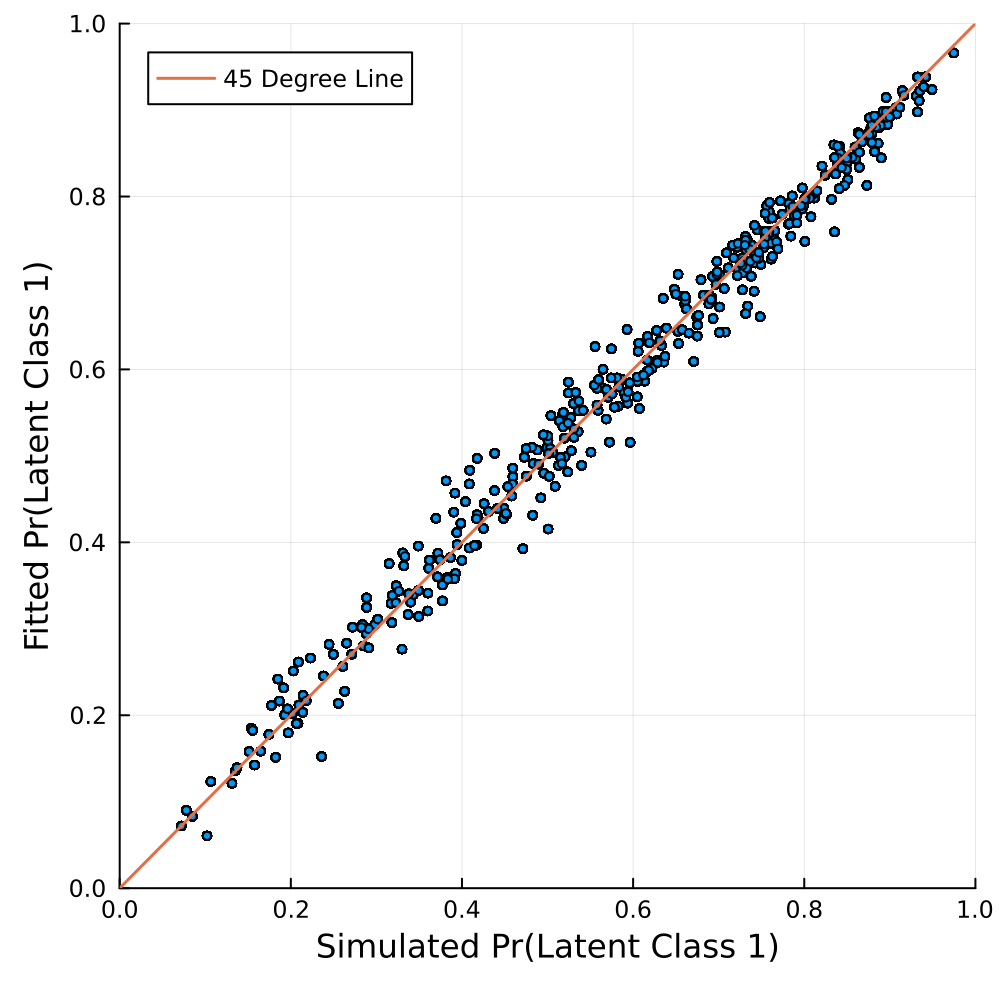

In [25]:
# comparison
plot(size=FIGSIZE, dpi=FIGDPI)
scatter!(true_gating_eval[:, 1], predicted_weights[:, 1];
    markersize=2.25,
    linealpha=0.30,
    label="",
    size=FIGSIZE)
xlims!(0, 1)
ylims!(0, 1)
xlabel!("Simulated Pr(Latent Class 1)")
ylabel!("Fitted Pr(Latent Class 1)")
plot!([0, 1], [0, 1]; linewidth=1.5, label="45 Degree Line", legend=:topleft)